# Spatial mapping of cell types across fetal organs (2/3) - cell2location

## Outline

The [**cell2location** workflow](https://github.com/vitkl/cell2location_paper/blob/master/paper/FigS1_cell2location_workflow.pdf) consists of three sections:

I. Estimating reference expression signatures of cell types (1/3)

II. Spatially mapping cell types (2/3, this notebook):

1. [Loading Visium data, QC](#1.-Loading-Visium-data)
2. [Visualise Visium data in spatial 2D and UMAP coordinates](#2.-Visualise-Visium-data-in-spatial-2D-and-UMAP-coordinates)
3. [Load reference cell type signature from snRNA-seq data and show UMAP of cells](#3.-Load-reference-cell-type-signature-from-snRNA-seq-data-and-show-UMAP-of-cells)
4. [Cell2location model description and analysis pipeline](#4.-Cell2location-model-description-and-analysis-pipeline),
[Evaluating training](#Evaluating-training)

III. Results and downstream analysis (3/3)


In [14]:
import os,sys        
import scanpy as sc
import squidpy as sq
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib as mpl

import scvi

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns

import torch

## 1. Loading Visium data <a name="1.-Loading-Visium-data"></a>

First, we need to download and unzip spatial data, as well as download estimated signatures of reference cell types:

In [2]:
# Set paths to data and results used through the document:
sp_data_folder = '/nfs/team205/ed6/data/Fetal_immune/spaceranger/'

# data_folder = '/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/data/'
# results_folder = '/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/results/'

# run_name_global = f'{results_folder}spatial_mapping_TH_fetal_TECs_revisedTissuefilter_v2annot_epochs50k'

# regression_model_output = 'signatures_PAN.A01.v01.c2l_reference.v2.subsetTH.exclude_lowQ.addTECs.keep_fetal_TECs_400epochs'
# reg_path = f'/nfs/team205/ed6/data/Fetal_immune/c2l_scRNA_references/{regression_model_output}/'

Now, let's read the spatial Visium data from the 10X Space Ranger output and examine several QC plots. Here, we load the our Visium mouse brain experiments (i.e. sections) and corresponding histology images into a single anndata object `adata`.

In [3]:
def read_and_qc(sample_name, path=sp_data_folder + 'rawdata/'):
    r""" This function reads the data for one 10X spatial experiment into the anndata object.
    It also calculates QC metrics. Modify this function if required by your workflow.
    
    :param sample_name: Name of the sample
    :param path: path to data
    """
    
    adata = sc.read_visium(path + str(sample_name),
                           count_file='filtered_feature_bc_matrix.h5', load_images=True)
    print('0' + sample_name)
    adata.obs['sample'] = sample_name
    adata.var['SYMBOL'] = adata.var_names
    adata.var.rename(columns={'gene_ids': 'ENSEMBL'}, inplace=True)
    adata.var_names = adata.var['ENSEMBL']
    adata.var.drop(columns='ENSEMBL', inplace=True)

    # Calculate QC metrics
    from scipy.sparse import csr_matrix
    adata.X = csr_matrix(adata.X)
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    print('1' + sample_name)
    adata.var['mt'] = [gene.startswith('mt-') for gene in adata.var['SYMBOL']]
    adata.obs['mt_frac'] = np.array(adata[:, adata.var['mt'].tolist()].X.sum(1)).flatten()/adata.obs['total_counts']
    print('2' + sample_name)

    # add sample name to obs names
    adata.obs["sample"] = [str(i) for i in adata.obs['sample']]
    adata.obs_names = adata.obs["sample"] \
                          + '_' + adata.obs_names
    adata.obs.index.name = 'spot_id'
    print('3' + sample_name)
    
    return adata

def select_slide(adata, s, s_col='sample', select_spatial=True):
    r""" This function selects the data for one slide from the spatial anndata object.
    
    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param s_col: column in adata.obs listing experiment name for each location
    """
    
    slide = adata[adata.obs[s_col].isin([s]), :].copy()
    if select_spatial:
        s_keys = list(slide.uns['spatial'].keys())
        s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

        slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}
    return slide

In [4]:
#######################
# Read the list of spatial experiments
sample_data = pd.read_csv('/home/jovyan/mount/gdrive/Pan_fetal/meta_share/panfetal_visium_metadata_v2.csv')

# Match metadata and file paths
from glob import glob
def find(lst, sample):
    return [i for i, x in enumerate(lst) if sample in x]
paths = glob(f'{sp_data_folder}*')
for i in sample_data.index:
    ind = find(paths, sample_data.loc[i, 'Sanger_ID'])
    if len(ind) == 1:
        sample_data.loc[i, 'paths'] = paths[ind[0]]

In [6]:
sample_data = sample_data.drop(['Data_dir', 'file'],1).copy()
sample_data.to_csv("../../../metadata/panfetal_visium_metadata_v2.csv")

---

In [26]:
sample_data = sample_data.loc[~sample_data['paths'].isna(), :]
sample_data['paths'] = sample_data['paths'].astype(str)
sample_data['sample_id'] = [os.path.basename(p) for p in sample_data['paths']]

In [29]:
sample_data.index = sample_data.Sanger_ID.values.copy()

In [47]:
sample_name = 'WSSS_F_IMMsp11604688'
sample_meta_ix = sample_data['Sanger_ID'] == sample_name
img_path = 'img_jpg/' + sample_data.loc[sample_name]['SN'] + "_" + sample_data.loc[sample_name]["Visium_Area_id"] + '.jpg'
sample_id = sample_data.loc[sample_name]['sample_id']
img_path

'img_jpg/V10U24-023_D1.jpg'

In [38]:
adata = read_and_qc(sample_id, path=sp_data_folder)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp11604688_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp11604688_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp11604688_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp11604688_GRCh38-2020-A


In [48]:
img = sq.im.ImageContainer(img = sp_data_folder + img_path)
178956970

In [58]:
help(sq.im.ImageContainer)

Help on class ImageContainer in module squidpy.im._container:

class ImageContainer(squidpy.im._feature_mixin.FeatureMixin)
 |  ImageContainer(img: 'Input_t | None' = None, layer: 'str' = 'image', lazy: 'bool' = True, scale: 'float' = 1.0, **kwargs: 'Any')
 |  
 |  Container for in memory arrays or on-disk images.
 |  
 |  Wraps :class:`xarray.Dataset` to store several image layers with the same `x`, `y` and `z` dimensions in one object.
 |  Dimensions of stored images are ``(y, x, z, channels)``. The channel dimension may vary between image layers.
 |  
 |  This class also allows for lazy loading and processing using :mod:`dask`, and is given to all image
 |  processing functions, along with :class:`anndata.AnnData` instance, if necessary.
 |  
 |  Parameters
 |  ----------
 |  img
 |      In-memory 2, 3 or 4-dimensional array or a path to an on-disk image.
 |  layer
 |      Image layer in ``img`` that should be processed. If `None` and only 1 layer is present, it will be selected.
 |

In [51]:
# helper function returning a clustering
def cluster_features(features: pd.DataFrame, like=None, res=0.25) -> pd.Series:
    """
    Calculate leiden clustering of features.

    Specify filter of features using `like`.
    """
    # filter features
    if like is not None:
        features = features.filter(like=like)
    # create temporary adata to calculate the clustering
    AnnVisTmp = ad.AnnData(features)
    # important - feature values are not scaled, so need to scale them before PCA
    sc.pp.scale(AnnVisTmp)
    # calculate leiden clustering
    sc.pp.pca(AnnVisTmp, n_comps=min(10, features.shape[1] - 1))
    sc.pp.neighbors(AnnVisTmp)
    sc.tl.leiden(AnnVisTmp,resolution=res)
    return AnnVisTmp.obs["leiden"]

def cluster_image_features(adata_vis, img):
#     # Load slide
#     adata_vis, img = read_slide_sq(vis_data_dir, sl)

    ### Calculate image features with squidpy

    # calculate features with masking - standard 
    sq.im.calculate_image_features(
        adata_vis,
        img,
        features=["summary", "texture", "histogram"],
    #     features=["summary"],
        key_added="features_masked_sq",
        mask_circle=True,
        spot_scale=1,
        show_progress_bar=True,
        n_jobs=12,
    )

    # make sure that we have no duplicated feature names in the combined table
    adata_vis.obsm["features_masked_sq"].columns = ad.utils.make_index_unique( adata_vis.obsm["features_masked_sq"].columns)

    # calculate feature clusters at different resolutions
    adata_vis.obs["features_masked_sq_cluster_025"] = cluster_features(adata_vis.obsm["features_masked_sq"], res=0.25, like="histogram")
    adata_vis.obs["features_masked_sq_cluster_030"] = cluster_features(adata_vis.obsm["features_masked_sq"], res=0.3,  like="histogram")
    adata_vis.obs["features_masked_sq_cluster_040"] = cluster_features(adata_vis.obsm["features_masked_sq"], res=0.4,  like="histogram")
    adata_vis.obs["features_masked_sq_cluster_050"] = cluster_features(adata_vis.obsm["features_masked_sq"], res=0.5,  like="histogram")

#     adata_vis.write_h5ad(outdir + sl + ".imgFeatures.h5ad")

In [56]:
# calculate features with masking - standard 
sq.im.calculate_image_features(
    adata,
    img,
    features=["histogram"],
#     features=["summary"],
    key_added="features_masked_sq",
    mask_circle=True,
    spot_scale=1,
    show_progress_bar=True,
    n_jobs=5,
)

  0%|          | 0/1615 [00:00<?, ?/s]

TerminatedWorkerError: A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.

The exit codes of the workers are {SIGKILL(-9)}

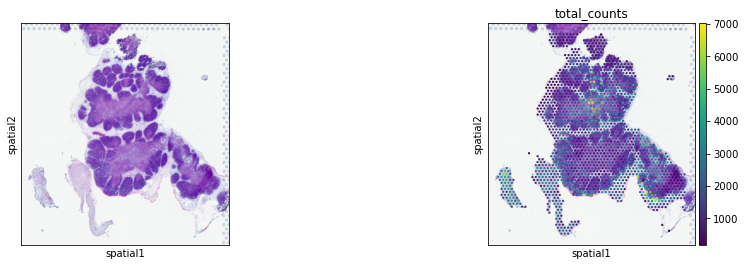

In [13]:
sc.pl.spatial(adata, color=[None, "total_counts"])

---

In [25]:
sample_data

,Sanger_ID,img_id,EXP_id,Organ,Fetal_id,SN,Visium_Area_id,Age_PCW,Digestion time,published,paths
0,WSSS_F_IMMsp9838712,F121_LP1_4LIV,LP1,liver,F121,V10U29-031,A1,18,18.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
1,WSSS_F_IMMsp9838709,F117_LP1_1SPL,LP1,spleen,F117,V10U29-031,D1,11,18.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
2,WSSS_F_IMMsp9838710,F121_LP1_2SPL,LP1,spleen,F121,V10U29-031,C1,18,18.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
3,WSSS_F_IMMsp9838711,F121_LP1_3THY,LP1,thymus,F121,V10U29-031,B1,18,24.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
4,WSSS_F_IMMsp9838717,F121_LP2_4LIV,LP2,liver,F121,V10U29-029,A1,18,18.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
5,WSSS_F_IMMsp9838714,F117_LP2_1SPL,LP2,spleen,F117,V10U29-029,D1,11,18.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
6,WSSS_F_IMMsp9838715,F121_LP2_2SPL,LP2,spleen,F121,V10U29-029,C1,18,18.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
7,WSSS_F_IMMsp9838716,F121_LP2_3THY,LP2,thymus,F121,V10U29-029,B1,18,24.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
8,WSSS_F_IMMsp10864177,F113_LP3_1SPL,LP3,spleen,F113,V10U29-028,D1,12,18.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
9,WSSS_F_IMMsp10864178,F122_LP3_2SPL,LP3,spleen,F122,V10U29-028,C1,15,18.0,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...


In [34]:
# Read the data into anndata objects
slides = []
for i in sample_data['sample_id'].values:
    slides.append(read_and_qc(i, path=sp_data_folder))

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A
1spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A
2spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A
3spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A
1spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A
2spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A
3spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A
1spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A
2spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A
3spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A
1spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A
2spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A
3spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A
1spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A
2spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A
3spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A
1spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A
2spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A
3spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A
1spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A
2spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A
3spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A
1spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A
2spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A
3spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864177_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864177_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864177_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864177_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864178_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864178_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864178_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864178_GRCh38-2020-A
0spaceranger130_count_WSSS_F_IMMsp10864180_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864180_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864180_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864180_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864184_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864184_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864184_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864184_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864181_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864181_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864181_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864181_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864182_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864182_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864182_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864182_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864183_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864183_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864183_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864183_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42704_WSSS_F_IMMsp11604681_GRCh38-2020-A
1spaceranger130_count_42704_WSSS_F_IMMsp11604681_GRCh38-2020-A
2spaceranger130_count_42704_WSSS_F_IMMsp11604681_GRCh38-2020-A
3spaceranger130_count_42704_WSSS_F_IMMsp11604681_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42704_WSSS_F_IMMsp11604682_GRCh38-2020-A
1spaceranger130_count_42704_WSSS_F_IMMsp11604682_GRCh38-2020-A
2spaceranger130_count_42704_WSSS_F_IMMsp11604682_GRCh38-2020-A
3spaceranger130_count_42704_WSSS_F_IMMsp11604682_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42704_WSSS_F_IMMsp11604683_GRCh38-2020-A
1spaceranger130_count_42704_WSSS_F_IMMsp11604683_GRCh38-2020-A
2spaceranger130_count_42704_WSSS_F_IMMsp11604683_GRCh38-2020-A
3spaceranger130_count_42704_WSSS_F_IMMsp11604683_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42704_WSSS_F_IMMsp11604684_GRCh38-2020-A
1spaceranger130_count_42704_WSSS_F_IMMsp11604684_GRCh38-2020-A
2spaceranger130_count_42704_WSSS_F_IMMsp11604684_GRCh38-2020-A
3spaceranger130_count_42704_WSSS_F_IMMsp11604684_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42702_WSSS_F_IMMsp11604685_GRCh38-2020-A
1spaceranger130_count_42702_WSSS_F_IMMsp11604685_GRCh38-2020-A
2spaceranger130_count_42702_WSSS_F_IMMsp11604685_GRCh38-2020-A
3spaceranger130_count_42702_WSSS_F_IMMsp11604685_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42702_WSSS_F_IMMsp11604686_GRCh38-2020-A
1spaceranger130_count_42702_WSSS_F_IMMsp11604686_GRCh38-2020-A
2spaceranger130_count_42702_WSSS_F_IMMsp11604686_GRCh38-2020-A
3spaceranger130_count_42702_WSSS_F_IMMsp11604686_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42702_WSSS_F_IMMsp11604687_GRCh38-2020-A
1spaceranger130_count_42702_WSSS_F_IMMsp11604687_GRCh38-2020-A
2spaceranger130_count_42702_WSSS_F_IMMsp11604687_GRCh38-2020-A
3spaceranger130_count_42702_WSSS_F_IMMsp11604687_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42702_WSSS_F_IMMsp11604688_GRCh38-2020-A
1spaceranger130_count_42702_WSSS_F_IMMsp11604688_GRCh38-2020-A
2spaceranger130_count_42702_WSSS_F_IMMsp11604688_GRCh38-2020-A
3spaceranger130_count_42702_WSSS_F_IMMsp11604688_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42727_WSSS_F_IMMsp11604689_GRCh38-2020-A
1spaceranger130_count_42727_WSSS_F_IMMsp11604689_GRCh38-2020-A
2spaceranger130_count_42727_WSSS_F_IMMsp11604689_GRCh38-2020-A
3spaceranger130_count_42727_WSSS_F_IMMsp11604689_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42727_WSSS_F_IMMsp11604690_GRCh38-2020-A
1spaceranger130_count_42727_WSSS_F_IMMsp11604690_GRCh38-2020-A
2spaceranger130_count_42727_WSSS_F_IMMsp11604690_GRCh38-2020-A
3spaceranger130_count_42727_WSSS_F_IMMsp11604690_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42727_WSSS_F_IMMsp11604691_GRCh38-2020-A
1spaceranger130_count_42727_WSSS_F_IMMsp11604691_GRCh38-2020-A
2spaceranger130_count_42727_WSSS_F_IMMsp11604691_GRCh38-2020-A
3spaceranger130_count_42727_WSSS_F_IMMsp11604691_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42727_WSSS_F_IMMsp11604692_GRCh38-2020-A
1spaceranger130_count_42727_WSSS_F_IMMsp11604692_GRCh38-2020-A
2spaceranger130_count_42727_WSSS_F_IMMsp11604692_GRCh38-2020-A
3spaceranger130_count_42727_WSSS_F_IMMsp11604692_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42728_WSSS_F_IMMsp11604693_GRCh38-2020-A
1spaceranger130_count_42728_WSSS_F_IMMsp11604693_GRCh38-2020-A
2spaceranger130_count_42728_WSSS_F_IMMsp11604693_GRCh38-2020-A
3spaceranger130_count_42728_WSSS_F_IMMsp11604693_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42728_WSSS_F_IMMsp11604694_GRCh38-2020-A
1spaceranger130_count_42728_WSSS_F_IMMsp11604694_GRCh38-2020-A
2spaceranger130_count_42728_WSSS_F_IMMsp11604694_GRCh38-2020-A
3spaceranger130_count_42728_WSSS_F_IMMsp11604694_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42728_WSSS_F_IMMsp11604695_GRCh38-2020-A
1spaceranger130_count_42728_WSSS_F_IMMsp11604695_GRCh38-2020-A
2spaceranger130_count_42728_WSSS_F_IMMsp11604695_GRCh38-2020-A
3spaceranger130_count_42728_WSSS_F_IMMsp11604695_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42728_WSSS_F_IMMsp11604696_GRCh38-2020-A
1spaceranger130_count_42728_WSSS_F_IMMsp11604696_GRCh38-2020-A
2spaceranger130_count_42728_WSSS_F_IMMsp11604696_GRCh38-2020-A
3spaceranger130_count_42728_WSSS_F_IMMsp11604696_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_43084_WSSS_F_IMMsp11765867_GRCh38-2020-A
1spaceranger130_count_43084_WSSS_F_IMMsp11765867_GRCh38-2020-A
2spaceranger130_count_43084_WSSS_F_IMMsp11765867_GRCh38-2020-A
3spaceranger130_count_43084_WSSS_F_IMMsp11765867_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_43084_WSSS_F_IMMsp11765868_GRCh38-2020-A
1spaceranger130_count_43084_WSSS_F_IMMsp11765868_GRCh38-2020-A
2spaceranger130_count_43084_WSSS_F_IMMsp11765868_GRCh38-2020-A
3spaceranger130_count_43084_WSSS_F_IMMsp11765868_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_43084_WSSS_F_IMMsp11765869_GRCh38-2020-A
1spaceranger130_count_43084_WSSS_F_IMMsp11765869_GRCh38-2020-A
2spaceranger130_count_43084_WSSS_F_IMMsp11765869_GRCh38-2020-A
3spaceranger130_count_43084_WSSS_F_IMMsp11765869_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A
1spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A
2spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A
3spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A


In [43]:
# Combine anndata objects together
adata = slides[0].concatenate(
    slides[1:],
    batch_key="sample",
    uns_merge="unique",
    batch_categories=sample_data['Sanger_ID'],
    index_unique=None
)

# Add sample annotations
sample_data = sample_data.set_index('Sanger_ID')
adata.obs[sample_data.columns] = sample_data.reindex(adata.obs['sample']).values
#######################

sample_data

,img_id,EXP_id,Organ,Fetal_id,SN,Visium_Area_id,Age_PCW,Digestion time,Data_dir,file,published,paths
Sanger_ID,,,,,,,,,,,,
WSSS_F_IMMsp9838712,F121_LP1_4LIV,LP1,liver,F121,V10U29-031,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838712,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
WSSS_F_IMMsp9838709,F117_LP1_1SPL,LP1,spleen,F117,V10U29-031,D1,11,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838709,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
WSSS_F_IMMsp9838710,F121_LP1_2SPL,LP1,spleen,F121,V10U29-031,C1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838710,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
WSSS_F_IMMsp9838711,F121_LP1_3THY,LP1,thymus,F121,V10U29-031,B1,18,24.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838711,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
WSSS_F_IMMsp9838717,F121_LP2_4LIV,LP2,liver,F121,V10U29-029,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838717,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
WSSS_F_IMMsp9838714,F117_LP2_1SPL,LP2,spleen,F117,V10U29-029,D1,11,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838714,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
WSSS_F_IMMsp9838715,F121_LP2_2SPL,LP2,spleen,F121,V10U29-029,C1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838715,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
WSSS_F_IMMsp9838716,F121_LP2_3THY,LP2,thymus,F121,V10U29-029,B1,18,24.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838716,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
WSSS_F_IMMsp10864177,F113_LP3_1SPL,LP3,spleen,F113,V10U29-028,D1,12,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp10864177,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...


In [44]:
adata.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,...,Organ,Fetal_id,SN,Visium_Area_id,Age_PCW,Digestion time,Data_dir,file,published,paths
spot_id,,,,,,,,,,,,,,,,,,,,,
spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A_AAACAAGTATCTCCCA-1,1.0,50.0,102.0,WSSS_F_IMMsp9838712,3628,8.196712,18818.0,9.842623,53.772983,61.281752,...,liver,F121,V10U29-031,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838712,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A_AAACAATCTACTAGCA-1,1.0,3.0,43.0,WSSS_F_IMMsp9838712,2429,7.795647,9769.0,9.187072,53.270550,60.569147,...,liver,F121,V10U29-031,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838712,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A_AAACAGAGCGACTCCT-1,1.0,14.0,94.0,WSSS_F_IMMsp9838712,3896,8.267962,21139.0,9.958922,55.182364,61.980226,...,liver,F121,V10U29-031,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838712,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A_AAACATTTCCCGGATT-1,1.0,61.0,97.0,WSSS_F_IMMsp9838712,1477,7.298445,6146.0,8.723720,61.731207,68.190693,...,liver,F121,V10U29-031,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838712,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A_AAACCCGAACGAAATC-1,1.0,45.0,115.0,WSSS_F_IMMsp9838712,2861,7.959276,15347.0,9.638741,59.536066,66.253991,...,liver,F121,V10U29-031,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838712,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A_TTGTTTCACATCCAGG-1,1.0,58.0,42.0,WSSS_F_IMMsp11765870,1465,7.290293,2860.0,7.958927,25.279720,36.363636,...,thymus,F135,V11M15-307,D1,16,NaN,/nfs/team205/ed6/data/Fetal_immune/spaceranger/,NaN,False,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A_TTGTTTCATTAGTCTA-1,1.0,60.0,30.0,WSSS_F_IMMsp11765870,2980,8.000014,6905.0,8.840146,23.895728,34.221579,...,thymus,F135,V11M15-307,D1,16,NaN,/nfs/team205/ed6/data/Fetal_immune/spaceranger/,NaN,False,/nfs/team205/ed6/data/Fetal_immune/spaceranger...
spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A_TTGTTTCCATACAACT-1,1.0,45.0,27.0,WSSS_F_IMMsp11765870,1067,6.973543,1909.0,7.554859,27.867994,38.763751,...,thymus,F135,V11M15-307,D1,16,NaN,/nfs/team205/ed6/data/Fetal_immune/spaceranger/,NaN,False,/nfs/team205/ed6/data/Fetal_immune/spaceranger...


In [16]:
# adata.obs['organ'].unique(), adata.obs['in_tissue'].value_counts()

2690

In [49]:
# Select tissue spots
adata = adata[adata.obs['in_tissue'] == 1.0, :]
adata = adata[~adata.obs['sample'].isin(['WSSS_F_IMMsp10864177', 'WSSS_F_IMMsp10864178']), :]
adata.obs['sample'] = adata.obs['sample'].astype(str)

# # Select thymus data
# adata = adata[adata.obs['Organ'].isin(['THY']), :]



Trying to set attribute `.obs` of view, copying.


<div class="alert alert-block alert-danger">
<b>Note!</b>
Mitochondia-encoded genes (gene names start with prefix mt- or MT-) are irrelevant for spatial mapping because their expression represents technical artifacts in the single cell and nucleus data rather than biological abundance of mitochondria. Yet these genes compose 15-40% of mRNA in each location. Hence, to avoid mapping artifacts we strongly recommend removing mitochondrial genes.
</div>

In [51]:
# mitochondria-encoded (MT) genes should be removed for spatial mapping
adata.obsm['mt'] = adata[:, adata.var['mt'].values].X.toarray()
adata = adata[:, ~adata.var['mt'].values]

In [113]:
metadata_df = adata.obs[['sample', 'Organ', "Age_PCW"]].drop_duplicates()
metadata_df

,sample,Organ,Age_PCW
spot_id,,,
spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A_AAACAAGTATCTCCCA-1,WSSS_F_IMMsp9838712,liver,18
spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A_AAACAAGTATCTCCCA-1,WSSS_F_IMMsp9838709,spleen,11
spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A_AAACAAGTATCTCCCA-1,WSSS_F_IMMsp9838710,spleen,18
spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A_AAACAAGTATCTCCCA-1,WSSS_F_IMMsp9838711,thymus,18
spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A_AAACAAGTATCTCCCA-1,WSSS_F_IMMsp9838717,liver,18
spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A_AAACAGCTTTCAGAAG-1,WSSS_F_IMMsp9838714,spleen,11
spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A_AAACCGGGTAGGTACC-1,WSSS_F_IMMsp9838715,spleen,18
spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A_AAACAGCTTTCAGAAG-1,WSSS_F_IMMsp9838716,thymus,18
spaceranger130_count_WSSS_F_IMMsp10864180_GRCh38-2020-A_AAACAAGTATCTCCCA-1,WSSS_F_IMMsp10864180,liver,15


<AxesSubplot:xlabel='Age_PCW', ylabel='Organ'>

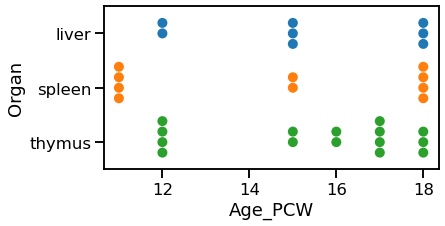

In [122]:
sns.set_context("talk")
plt.rcParams['figure.figsize'] = [6,3]
sns.swarmplot(data=metadata_df, y='Organ', x='Age_PCW', size=10)

### Look at QC metrics

Now let's look at QC: total number of counts and total number of genes per location across Visium experiments.

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level functi

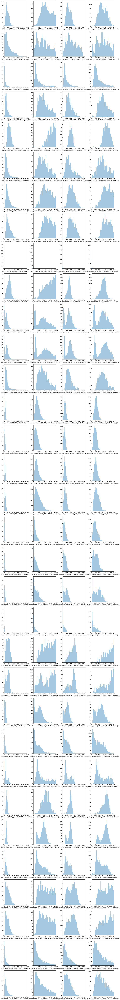

In [53]:
# PLOT QC FOR EACH SAMPLE 
sample_col = 'sample'
organ_col = 'Organ'
age_col = 'Age_PCW'
fig, axs = plt.subplots(len(adata.obs[sample_col].unique()), 4, figsize=(15, 4*len(adata.obs[sample_col].unique())-4))
for i, s in enumerate(adata.obs[sample_col].unique()):
    #fig.suptitle('Covariates for filtering')
    
    slide = select_slide(adata, s, select_spatial=False)
    s_lab = f'{slide.obs[sample_col][0]} | {slide.obs[organ_col][0]} | {slide.obs[age_col][0]}'
    sns.distplot(slide.obs['total_counts'], 
                 kde=False, ax = axs[i, 0])
    axs[i, 0].set_xlim(0, adata.obs['total_counts'].max())
    axs[i, 0].set_xlabel(f'total_counts | {s_lab}')
    
    sns.distplot(slide.obs['total_counts']\
                 [slide.obs['total_counts']<20000],
                 kde=False, bins=40, ax = axs[i, 1])
    axs[i, 1].set_xlim(0, 20000)
    axs[i, 1].set_xlabel(f'total_counts | {s_lab}')
    
    sns.distplot(slide.obs['n_genes_by_counts'],
                 kde=False, bins=60, ax = axs[i, 2])
    axs[i, 2].set_xlim(0, adata.obs['n_genes_by_counts'].max())
    axs[i, 2].set_xlabel(f'n_genes_by_counts | {s_lab}')
    
    sns.distplot(slide.obs['n_genes_by_counts']\
                 [slide.obs['n_genes_by_counts']<6000],
                 kde=False, bins=60, ax = axs[i, 3])
    axs[i, 3].set_xlim(0, 6000)
    axs[i, 3].set_xlabel(f'n_genes_by_counts | {s_lab}')
    
plt.tight_layout()

## 2. Visualise Visium data in spatial 2D and UMAP coordinates <a name="2.-Visualise-Visium-data-in-spatial-2D-and-UMAP-coordinates"></a>

### Visualising data in spatial coordinates with scanpy

Next, we show how to plot these QC values over the histology image using standard scanpy tools

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'img_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'EXP_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'Organ' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'Fetal_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'SN' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'Visium_Area_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'Data_dir' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'file' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'paths' as categ

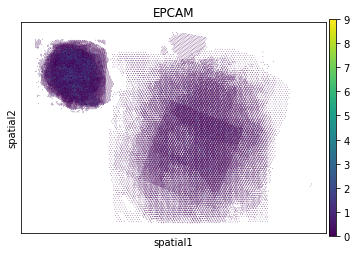

In [54]:
# scanpy tends to issue a lot of warning when plotting - so plot everything once to avoid repeating the same warnings
sc.pl.spatial(adata, 
              color=["EPCAM"], img_key=None,
              vmin=0, library_id='spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A',
              gene_symbols='SYMBOL'
             )

In [86]:
def plot_spatial_per_cell_type(adata, 
                                   cell_type='total_counts',
                                   samples=adata.obs['sample'].cat.categories,
                                  ncol=3, prefix='', figsize=(24, 36), vmax_quantile=0.992):
    n_samples = len(samples)
    nrow = int(np.ceil(n_samples / ncol))
    fig, axs = plt.subplots(nrow, ncol, figsize=figsize)
    if nrow == 1:
        axs = axs.reshape((1, ncol))
    
    col_name = f'{prefix}{cell_type}'
    vmax = np.quantile(adata.obs[col_name].values, vmax_quantile)
    adata.obs[cell_type] = adata.obs[col_name].copy()
    
    from itertools import chain
    ind = list(chain(*[[(i, j) for i in range(nrow)] for j in range(ncol)]))
    
    for i, s in enumerate(samples):
        sp_data_s = select_slide(adata, s, s_col='sample')
        sc.pl.spatial(sp_data_s, cmap='magma',
                      color=cell_type, 
                      size=1.3, img_key='hires', alpha_img=0.5, 
                      vmin=0, ax=axs[ind[i][0],ind[i][1]], show=False
                                            )
        axs[ind[i][0],ind[i][1]].title.set_text(cell_type+'\n'+s)
        
    if len(samples) < len(axs.flatten()):
        for i in range(len(samples), len(axs.flatten())):
            axs[ind[i][0],ind[i][1]].axis('off')
        
    fig.tight_layout(pad=0.5)
        
    return fig
    

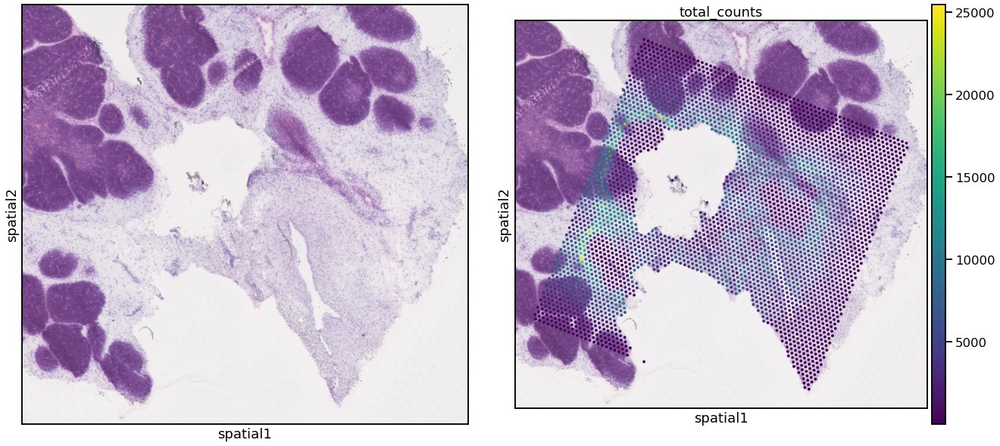

In [124]:
sp_data_s = select_slide(adata, 'WSSS_F_IMMsp11604692', s_col='sample')
plt.rcParams['figure.figsize'] = [10,10]
sc.pl.spatial(sp_data_s, color=[None, "total_counts"])

In [123]:
adata.obs.loc[adata.obs['Organ'] == 'thymus', 'sample'].unique()

['WSSS_F_IMMsp9838711', 'WSSS_F_IMMsp9838716', 'WSSS_F_IMMsp10864183', 'WSSS_F_IMMsp11604685', 'WSSS_F_IMMsp11604686', ..., 'WSSS_F_IMMsp11604692', 'WSSS_F_IMMsp11765867', 'WSSS_F_IMMsp11765868', 'WSSS_F_IMMsp11765869', 'WSSS_F_IMMsp11765870']
Length: 15
Categories (15, object): ['WSSS_F_IMMsp9838711', 'WSSS_F_IMMsp9838716', 'WSSS_F_IMMsp10864183', 'WSSS_F_IMMsp11604685', ..., 'WSSS_F_IMMsp11765867', 'WSSS_F_IMMsp11765868', 'WSSS_F_IMMsp11765869', 'WSSS_F_IMMsp11765870']

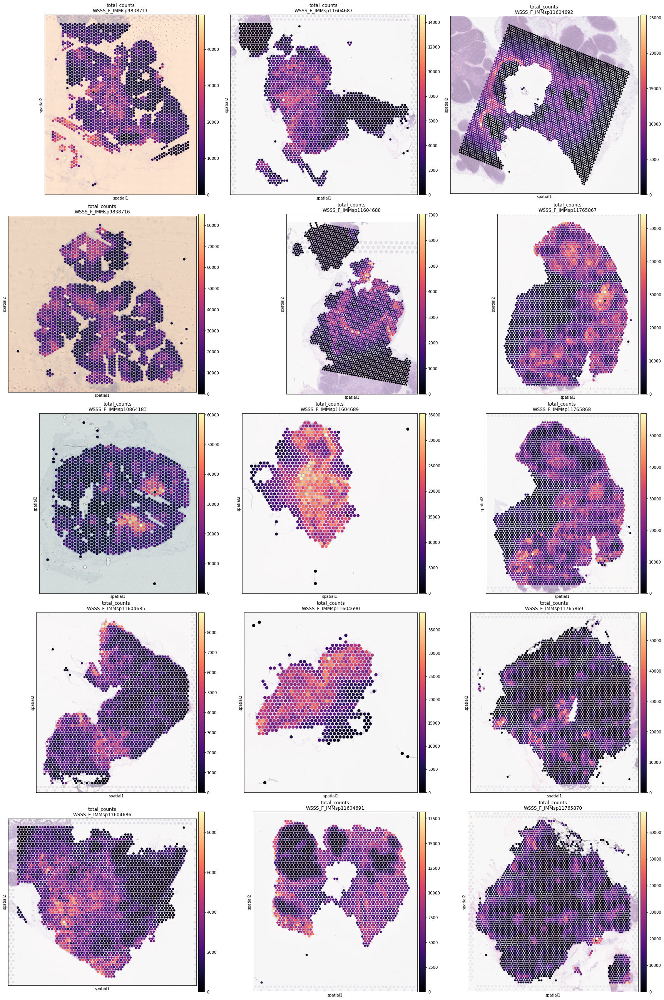

In [90]:
fig = plot_spatial_per_cell_type(adata, cell_type='total_counts', samples=adata.obs.loc[adata.obs['Organ'] == 'thymus', 'sample'].unique())

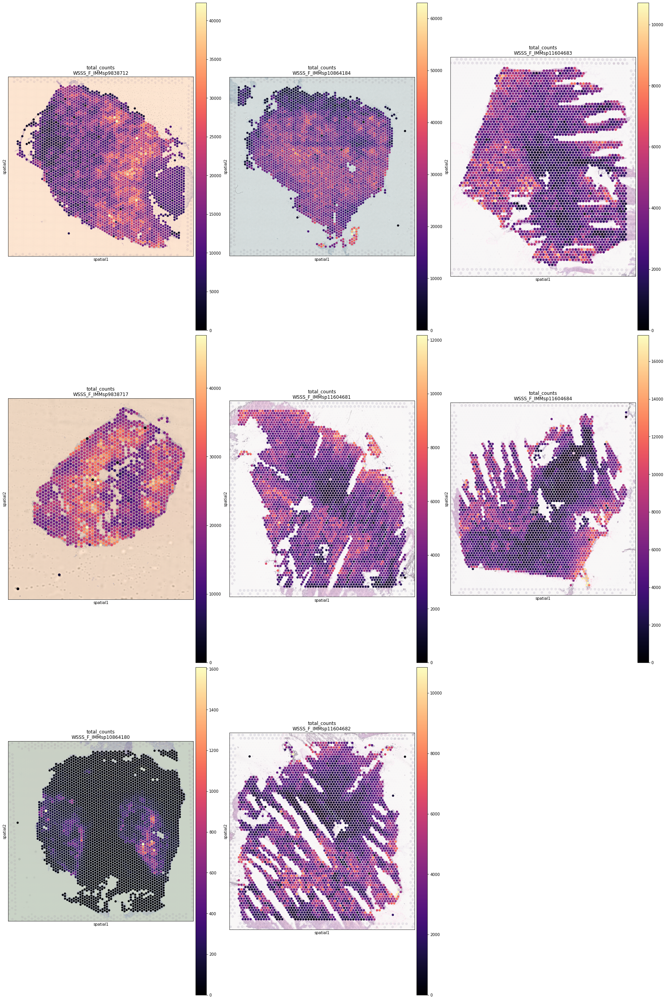

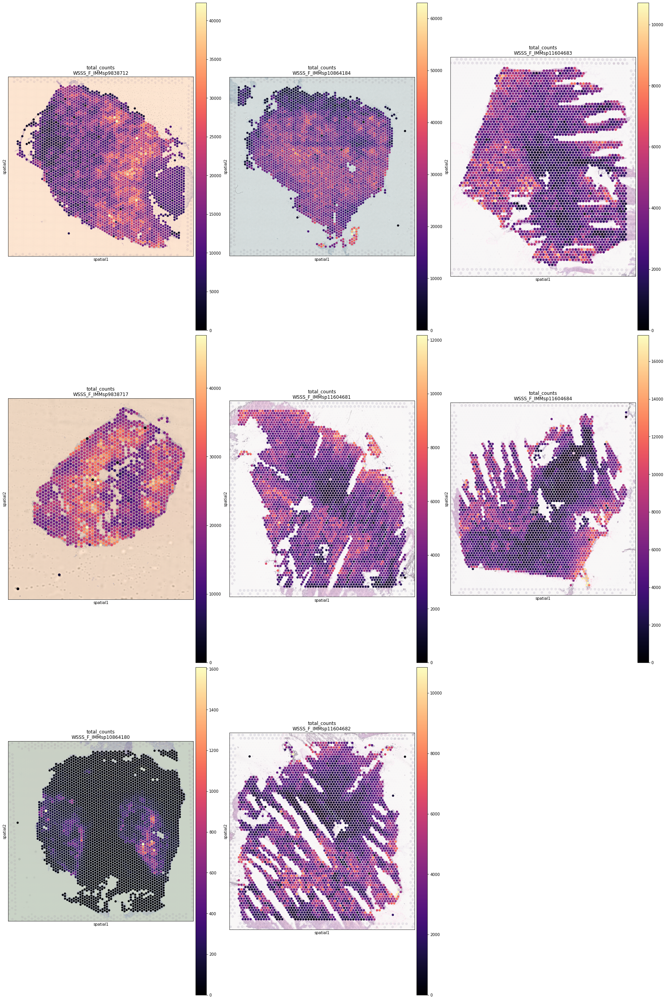

In [88]:
plot_spatial_per_cell_type(adata, cell_type='total_counts', samples=adata.obs.loc[adata.obs['Organ'] == 'liver', 'sample'].unique())

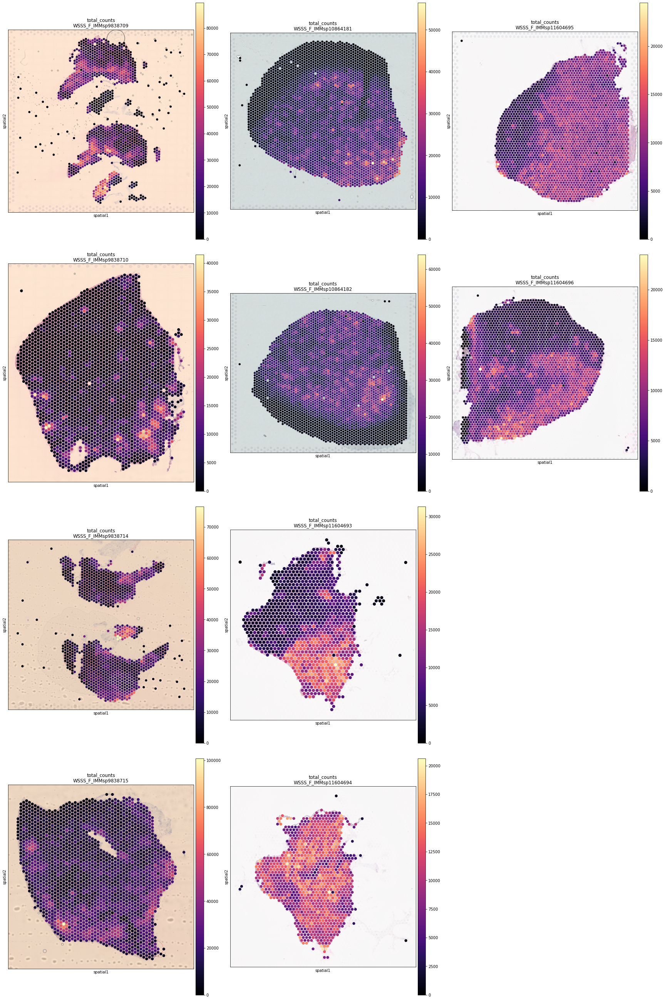

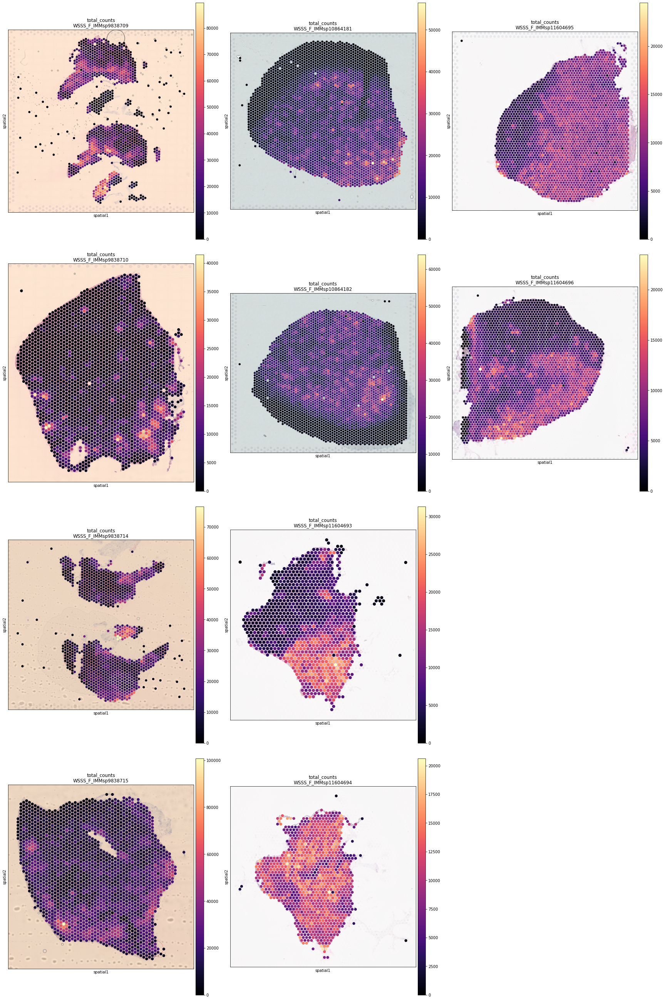

In [89]:
plot_spatial_per_cell_type(adata, cell_type='total_counts', samples=adata.obs.loc[adata.obs['Organ'] == 'spleen', 'sample'].unique())

### Construct and examine UMAP of locations

Now we apply the standard scanpy processing pipeline to the spatial Visium data to show experiment to experiment variability in the data. Importatly, this workflow will show the extent of batch differences in your data (cell2location works on samples jointly, see below).

In this mouse brain dataset, only a few regions should be different between sections because we are using 2 samples from biological replicates sectioned at a slightly different location along the anterior-posterior axis in the mouse brain. We see general alighnment of locations from both experiments and some mismatches, but as you will see in the downstream analysis notebook most of the differences between experiments here come from batch effect, which cell2location can account for.

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


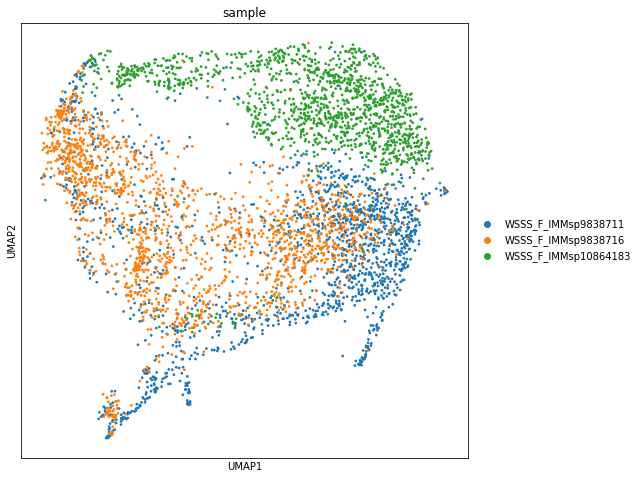

In [11]:
adata_vis_plt = adata.copy()

# Log-transform (log(data + 1))
sc.pp.log1p(adata_vis_plt)

# Find highly variable genes within each sample
adata_vis_plt.var['highly_variable'] = False
for s in adata_vis_plt.obs['sample'].unique():
    
    adata_vis_plt_1 = adata_vis_plt[adata_vis_plt.obs['sample'].isin([s]), :]
    sc.pp.highly_variable_genes(adata_vis_plt_1, min_mean=0.0125, max_mean=5, min_disp=0.5, n_top_genes=1000)
    
    hvg_list = list(adata_vis_plt_1.var_names[adata_vis_plt_1.var['highly_variable']])
    adata_vis_plt.var.loc[hvg_list, 'highly_variable'] = True
    
# Scale the data ( (data - mean) / sd )
sc.pp.scale(adata_vis_plt, max_value=10)
# PCA, KNN construction, UMAP
sc.tl.pca(adata_vis_plt, svd_solver='arpack', n_comps=40, use_highly_variable=True)
sc.pp.neighbors(adata_vis_plt, n_neighbors = 20, n_pcs = 40, metric='cosine')
sc.tl.umap(adata_vis_plt, min_dist = 0.3, spread = 1)

with mpl.rc_context({'figure.figsize': [8, 8],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(adata_vis_plt, color=['sample', #'Organ', 'Age_PCW'
                                    ], size=30,
               color_map = 'RdPu', ncols = 1, #legend_loc='on data',
               legend_fontsize=10)

## 3. Load reference cell type signature from snRNA-seq data and show UMAP of cells <a name="3.-Load-reference-cell-type-signature-from-snRNA-seq-data-and-show-UMAP-of-cells"></a>

Next, we load the pre-processed snRNAseq reference anndata object that contains estimated expression signatures of reference cell types (see notebook 1/3).

In [12]:
reg_path

'/nfs/team205/ed6/data/Fetal_immune/c2l_scRNA_references/signatures_PAN.A01.v01.c2l_reference.v2.subsetTH.exclude_lowQ.addTECs.keep_fetal_TECs_400epochs/'

In [13]:
## snRNAseq reference (raw counts)
adata_ref = sc.read(f'{reg_path}sc.h5ad')

In [14]:
adata_ref.obs['organ']

FCAImmP7277564-AGAGTGGTCTCATTCA-0            TH
FCAImmP7277564-CCGTACTGTCTTGTCC-0            TH
FCAImmP7277564-CAACCTCAGCTACCGC-0            TH
FCAImmP7277564-GTGAAGGTCAAACGGG-0            TH
FCAImmP7277564-CGACCTTCAAAGTGCG-0            TH
                                             ..
Human_colon_16S7985397-CTGCTGTTCACCGTAA-1    TH
Human_colon_16S7985397-GATCGCGTCTGTCTCG-1    TH
Human_colon_16S7985397-GGACGTCTCTATGTGG-1    TH
Human_colon_16S7985397-GGATGTTGTCAAAGAT-1    TH
Human_colon_16S7985397-TTCCCAGGTGTTTGTG-1    TH
Name: organ, Length: 113753, dtype: category
Categories (1, object): ['TH']

In [15]:
adata_ref.var['GeneID'] = adata_ref.var['GeneID-1'].astype(str).copy()
adata_ref.var.loc[adata_ref.var['GeneID-1'] == 'nan', 'GeneID'] = adata_ref.var.loc[adata_ref.var['GeneID-1'] == 'nan', 'GeneID-0']
# Remove duplicated ENSEMBL IDs
adata_ref = adata_ref[:, ~adata_ref.var['GeneID'].duplicated()]

Export reference expression signatures of cell types:

In [16]:
# export estimated expression in each cluster
if 'means_per_cluster_mu_fg' in adata_ref.varm.keys():
    inf_aver = adata_ref.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}' 
                                    for i in adata_ref.uns['mod']['factor_names']]].copy()
else:
    inf_aver = adata_ref.var[[f'means_per_cluster_mu_fg_{i}' 
                                    for i in adata_ref.uns['mod']['factor_names']]].copy()
inf_aver.columns = adata_ref.uns['mod']['factor_names']
inf_aver.index = adata_ref.var['GeneID'][inf_aver.index].values
inf_aver.iloc[0:5, 0:5]

,ABT(ENTRY),B1,CD4+T,CD8+T,CD8AA
ENSG00000121410,0.438070,0.278138,0.215159,0.831240,0.554645
ENSG00000175899,0.000222,0.006092,0.000497,0.000385,0.001252
ENSG00000166535,0.000465,0.053943,0.000515,0.000379,0.000424
ENSG00000128274,0.000134,0.092082,0.000208,0.000351,0.000854
ENSG00000094914,0.089826,0.180988,0.121940,0.168966,0.226513


Quick look at the cell type composition in our reference data in UMAP coordinates (UMAP representation was generated using a standard scanpy workflow, see notebook 1/3).

In [17]:
adata_ref.obs

,method,donor,Sample.lanes,anno_c2l,organ,age,n_genes,_scvi_batch,_scvi_labels,_scvi_local_l_mean,_scvi_local_l_var,_indices
FCAImmP7277564-AGAGTGGTCTCATTCA-0,3GEX,F30,FCAImmP7277564,TREG,TH,14.0,6233,6,63,9.022787,0.413983,0
FCAImmP7277564-CCGTACTGTCTTGTCC-0,3GEX,F30,FCAImmP7277564,CD8AA,TH,14.0,6128,6,4,9.022787,0.413983,1
FCAImmP7277564-CAACCTCAGCTACCGC-0,3GEX,F30,FCAImmP7277564,CYCLING_B,TH,14.0,5343,6,7,9.022787,0.413983,2
FCAImmP7277564-GTGAAGGTCAAACGGG-0,3GEX,F30,FCAImmP7277564,DC1,TH,14.0,5306,6,12,9.022787,0.413983,3
FCAImmP7277564-CGACCTTCAAAGTGCG-0,3GEX,F30,FCAImmP7277564,DP(P)_T,TH,14.0,5628,6,17,9.022787,0.413983,4
...,...,...,...,...,...,...,...,...,...,...,...,...
Human_colon_16S7985397-CTGCTGTTCACCGTAA-1,5GEX,F74,nan,cTEC,TH,NaN,1796,32,67,9.339835,0.421643,113748
Human_colon_16S7985397-GATCGCGTCTGTCTCG-1,5GEX,F74,nan,cTEC,TH,NaN,1615,32,67,9.339835,0.421643,113749
Human_colon_16S7985397-GGACGTCTCTATGTGG-1,5GEX,F74,nan,cTEC,TH,NaN,1836,32,67,9.339835,0.421643,113750
Human_colon_16S7985397-GGATGTTGTCAAAGAT-1,5GEX,F74,nan,mcTEC,TH,NaN,1245,32,71,9.339835,0.421643,113751


In [18]:
# find shared genes and subset both anndata and reference signatures
adata_vis = adata.copy()
intersect = np.intersect1d(adata_vis.var_names, inf_aver.index)
adata_vis = adata_vis[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()

# prepare anndata for scVI model
scvi.data.setup_anndata(adata=adata_vis, batch_key="sample")
scvi.data.view_anndata_setup(adata_vis)

INFO     Using batches from adata.obs["sample"]                                              
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function setup_anndata is deprecated; Please use the model-specific setup_anndata methods instead. The global method will be removed in version 0.15.0.


INFO     Successfully registered anndata object containing 4675 cells, 14786 vars, 3 batches,
         1 labels, and 0 proteins. Also registered 0 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function view_anndata_setup is deprecated; This method will be removed in 0.15.0. Please avoid building any new dependencies on it.


Anndata setup with scvi-tools version 0.14.3.

              Data Summary              
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃             Data             ┃ Count ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│            Cells             │ 4675  │
│             Vars             │ 14786 │
│            Labels            │   1   │
│           Batches            │   3   │
│           Proteins           │   0   │
│ Extra Categorical Covariates │   0   │
│ Extra Continuous Covariates  │   0   │
└──────────────────────────────┴───────┘

             SCVI Data Registry              
┏━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃     Data      ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│       X       │          adata.X          │
│ batch_indices │ adata.obs['_scvi_batch']  │
│    labels     │ adata.obs['_scvi_labels'] │
└───────────────┴───────────────────────────┘

                        Label Categories                        
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                          Batch Categories                          
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃      Categories      ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │ WSSS_F_IMMsp9838711  │          0          │
│                     │ WSSS_F_IMMsp9838716  │          1          │
│                     │ WSSS_F_IMMsp10864183 │          2          │
└─────────────────────┴──────────────────────┴─────────────────────┘

In [19]:
alphas = [20]

for alpha in alphas:
    # create and train the model
    scvi_run_name = f'{run_name_global}_alphatest{alpha}'
    print(scvi_run_name)
    import pyro
    mod = cell2location.models.Cell2location(
        adata_vis, cell_state_df=inf_aver, 
        amortised=False,
        N_cells_per_location=30,
        detection_alpha=alpha,
        #detection_hyp_prior={"alpha": alpha, "mean_alpha": 10.0},
    ) 

    mod.train(max_epochs=50000, 
              batch_size=None, 
              train_size=1,
              #plan_kwargs={'optim': pyro.optim.ClippedAdam(optim_args={'lr': 0.002, 'clip_norm': 10})},
              plan_kwargs={'optim': pyro.optim.Adam(optim_args={'lr': 0.002})},
              use_gpu=True)

    # In this section, we export the estimated cell abundance (summary of the posterior distribution).
    adata_vis = mod.export_posterior(
        adata_vis, sample_kwargs={'num_samples': 1000, 'batch_size': int(adata_vis.n_obs), 'use_gpu': True}
    )

    # Save model
    mod.save(f"{scvi_run_name}", overwrite=True)
    # can be loaded later like this:
    # mod = scvi.external.Cell2location.load(f"{scvi_run_name}", adata_vis)

    # Save anndata object with results
    adata_vis.obs['Age_PCW'] = adata_vis.obs['Age_PCW'].astype(str)
    adata_vis.obs['nBlocks'] = adata_vis.obs['nBlocks'].astype(str)
    adata_vis.obs['Block_ID'] = adata_vis.obs['Block_ID'].astype(str)
    adata_vis.obs['Digestion time'] = adata_vis.obs['Digestion time'].astype(str)
    adata_vis.obs['Repeats'] = adata_vis.obs['Repeats'].astype(str)
    adata_vis.obs['Notes'] = adata_vis.obs['Notes'].astype(str)
    adata_vis.obs['Date_sectioned'] = adata_vis.obs['Date_sectioned'].astype(str)
    adata_vis.obs['in_tissue'] = adata_vis.obs['in_tissue'].astype(str)
    adata_file = f"{scvi_run_name}/sp.h5ad"
    adata_vis.write(adata_file)

    # plot ELBO loss history during training, removing first 100 epochs from the plot
    mod.plot_history(5000)
    plt.savefig(f"{scvi_run_name}/training_ELBO_history_minus5k.png",
                bbox_inches='tight')
    plt.close()
    mod.plot_history(0)
    plt.savefig(f"{scvi_run_name}/training_ELBO_history_all.png",
                bbox_inches='tight')
    plt.close()
       
    # Examine reconstruction accuracy to assess if there are any issues with mapping
    # the plot should be roughly diagonal, strong deviations will signal problems
    mod.plot_QC()
    plt.savefig(f"{scvi_run_name}/reconstruction_accuracy_histogram.png",
                bbox_inches='tight')
    plt.close()

    # add 5% quantile, representing confident cell abundance, 'at least this amount is present', 
    # to adata.obs with nice names for plotting
    adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

    fig_dir = f"{scvi_run_name}/spatial/"
    import os
    if not os.path.exists(fig_dir):
        os.mkdir(fig_dir)
    adata_vis.obs['total_cell_abundance'] = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1).flatten()
    fig = plot_spatial_per_cell_type(adata_vis, cell_type='total_cell_abundance', prefix='');
    fig.savefig(f"{fig_dir}total_cell_abundance.png", bbox_inches='tight')
    fig.clear()
    plt.close(fig)

    adata_vis.obs['detection_y_s'] = adata_vis.uns['mod']['post_sample_q05']['detection_y_s']
    fig = plot_spatial_per_cell_type(adata_vis, cell_type='detection_y_s', prefix='');
    fig.savefig(f"{fig_dir}detection_y_s.png", bbox_inches='tight')
    fig.clear()
    plt.close(fig)

    fig = plot_spatial_per_cell_type(adata_vis, cell_type='total_counts', prefix='');
    fig.savefig(f"{fig_dir}total_RNA_counts.png", bbox_inches='tight')
    fig.clear()
    plt.close(fig)

    from re import sub
    import os
    for c in adata_vis.uns['mod']['factor_names']:
        fig = plot_spatial_per_cell_type(adata_vis, cell_type=c)
        fig_dir = f"{scvi_run_name}/spatial/"
        if not os.path.exists(fig_dir):
            os.mkdir(fig_dir)
        fig_dir = f"{scvi_run_name}/spatial/per_cell_type/"
        if not os.path.exists(fig_dir):
            os.mkdir(fig_dir)
        fig.savefig(f"{fig_dir}W_cell_abundance_q05_{sub('/', '_', c)}.png",
                    bbox_inches='tight')
        fig.clear()
        plt.close(fig)

    f"{scvi_run_name}/spatial/per_cell_type/"

    with mpl.rc_context({"axes.facecolor": "black"}):
        clust_names = adata_vis.uns['mod']['factor_names']

        for s in adata_vis.obs['sample'].unique():

            s_ind = adata_vis.obs['sample'] == s
            s_keys = list(adata_vis.uns['spatial'].keys())
            s_spatial = np.array(s_keys)[[s in i for i in s_keys]][0]

            fig = sc.pl.spatial(adata_vis[s_ind, :], cmap='magma',
                                color=clust_names, ncols=5, library_id=s_spatial,
                                size=1.3, img_key='hires', alpha_img=1,
                                vmin=0, vmax='p99.2',
                                return_fig=True, show=False)

            fig_dir = f"{scvi_run_name}/spatial/"
            if not os.path.exists(fig_dir):
                os.mkdir(fig_dir)
            fig_dir = f"{scvi_run_name}/spatial/per_sample/"
            if not os.path.exists(fig_dir):
                os.mkdir(fig_dir)

            plt.savefig(f"{fig_dir}W_cell_abundance_q05_{s}.png",
                        bbox_inches='tight')
            plt.close()

    # add 5% quantile, representing confident cell abundance, 'at least this amount is present', 
    # to adata.obs with nice names for plotting
    adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

    # look at the total cell abundance for each experiment
    with mpl.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                         'figure.figsize': [5, 15]}):
        for i, n in enumerate(adata_vis.obs['sample'].unique()):
            plt.subplot(len(adata_vis.obs['sample'].unique()), 1, i+1)
            total_cell_abundance = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1).flatten()
            total_cell_abundance_ = total_cell_abundance[adata_vis.obs['sample'] == n]
            plt.hist(total_cell_abundance_, bins=100);
            plt.title(n)
            plt.xlabel(r'Total cell abundance ($sum_f w_sf$) for each experiment')
            plt.xlim(0, total_cell_abundance.max())
        plt.savefig(f"{scvi_run_name}/total_cell_abundance.png",
                    bbox_inches='tight')
        plt.close()
     

/nfs/team205/vk7/sanger_projects/collaborations/pan_fetal_immune_mapping/results/spatial_mapping_TH_fetal_TECs_revisedTissuefilter_v2annot_epochs50k_alphatest20


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/pytorch_lightning/trainer/configuration_validator.py:99: UserWarning: you passed in a val_dataloader but have no validation_step. Skipping val loop
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Sampling global variables, sample: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 999/999 [01:10<00:00, 14.26it/s]


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
... storing 'in_tissue' as categorical
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
... storing 'Age_PCW' as categorical
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unu

## Run tissue zone analysis

In [20]:
from cell2location import run_colocation
res_dict, adata_vis = run_colocation(
    adata_vis,
    model_name='CoLocatedGroupsSklearnNMF',
    train_args={
      'n_fact': np.arange(10, 20), # IMPORTANT: use a wider range of the number of factors (5-30)
      'sample_name_col': 'sample', # columns in adata_vis.obs that identifies sample
      'n_restarts': 3 # number of training restarts
    },
    export_args={'path': f'{scvi_run_name}/CoLocatedComb/'}
)

### Analysis name: CoLocatedGroupsSklearnNMF_10combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_11combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_12combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_13combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_14combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_15combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_16combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_17combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_18combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


### Analysis name: CoLocatedGroupsSklearnNMF_19combinations_4675locations_72factors


/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
/nfs/team283/vk7/software/miniconda3farm5/envs/cell2loc_env99/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead


Modules and their versions used for this analysis

In [21]:
cell2location.utils.list_imported_modules()

sys 3.9.7 (default, Sep 16 2021, 13:09:58) 
[GCC 7.5.0]
re 2.2.1
ipykernel._version 6.4.1
json 2.0.9
jupyter_client._version 7.0.6
traitlets._version 5.1.0
traitlets 5.1.0
logging 0.5.1.2
platform 1.0.8
_ctypes 1.1.0
ctypes 1.1.0
zmq.backend.cython.constants 40304
zmq.backend.cython 40304
zmq.sugar.constants 40304
zmq.sugar.version 22.3.0
zmq.sugar 22.3.0
zmq 22.3.0
argparse 1.1
tornado 6.1
zlib 1.0
colorama 0.4.4
_curses b'2.2'
dateutil._version 2.8.2
dateutil 2.8.2
six 1.16.0
_decimal 1.70
decimal 1.70
jupyter_core.version 4.8.1
jupyter_core 4.8.1
entrypoints 0.3
jupyter_client 7.0.6
ipykernel 6.4.1
IPython.core.release 7.28.0
pygments 2.10.0
ptyprocess 0.7.0
pexpect 4.8.0
IPython.core.crashhandler 7.28.0
decorator 5.1.0
pickleshare 0.7.5
backcall 0.2.0
_sqlite3 2.6.0
sqlite3.dbapi2 2.6.0
sqlite3 2.6.0
wcwidth 0.2.5
prompt_toolkit 3.0.20
parso 0.8.2
jedi 0.18.0
urllib.request 3.9
IPython.core.magics.code 7.28.0
IPython 7.28.0
ipython_genutils._version 0.2.0
ipython_genutils 0.2.0
dis